 Cultural Remix
======
### Amar Shah and Sonia Nigam
#### EECS352


In [6]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath,math
from IPython.display import Audio
import librosa
import pickle
import os
from os import listdir
import msaf

# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline

In [2]:
#taken from HW0
def wavwrite(filepath, data, sr, norm=True, dtype='int16',):
    '''
    Write wave file using scipy.io.wavefile.write, converting from a float (-1.0 : 1.0) numpy array to an integer array
    
    Parameters
    ----------
    filepath : str
        The path of the output .wav file
    data : np.array
        The float-type audio array
    sr : int
        The sampling rate
    norm : bool
        If True, normalize the audio to -1.0 to 1.0 before converting integer
    dtype : str
        The output type. Typically leave this at the default of 'int16'.
    '''
    if norm:
        data /= np.max(np.abs(data))
    data = data * np.iinfo(dtype).max
    data = data.astype(dtype)
    sp.io.wavfile.write(filepath, sr, data)

In [3]:
signal, sr = librosa.load('HipHop/headlines.wav.m4a', sr=44100)
D = librosa.stft(signal)

#split into two parts: percussive and harmonic
D_harmonic, D_percussive = librosa.decompose.hpss(D)

D_harmonic_audio = librosa.istft(D_harmonic)
D_percussive_audio = librosa.istft(D_percussive)

tune = np.concatenate((signal, D_harmonic_audio,D_percussive_audio))
tune2 = np.concatenate((D_harmonic_audio,D_percussive_audio ))
#saves percussive component
wavwrite('percussive.mp3', D_percussive_audio, sr)
Audio(D_percussive_audio, rate=sr)

In [4]:
def get_music_samples(music, start_frame, end_frame, hop_length):
    """
        input:
            music - vector of samples for the musical signal - output by librosa.
            hop_length - hop_length for the feature vector computation
            start_frame - frame index to start at
            end_frame - frame index to end at
        output:
            chunk - samples corresponding to between and including the start and end frame
    """
    chunk = music[start_frame * hop_length: end_frame * hop_length]
    return chunk

In [7]:
hop_length = 512

#gets hip hop audio beats
tempo, beats = librosa.beat.beat_track(D_percussive_audio, sr=sr, hop_length=hop_length)

#get segment boundaries based on percussive background
boundaries, labels = msaf.process('percussive.mp3', boundaries_id="foote")
boundaries_final = [boundaries[0]]

#check to see if any samples are too close together, delete if so
for i in xrange(1,len(boundaries)-1):
    if boundaries[i] - boundaries[i-1] < 1.75:
        pass
    else:
        boundaries_final.append(boundaries[i])
    
#convert time indicies into frame indices
boundaries_frames = librosa.core.time_to_frames(boundaries_final, sr=sr)

2


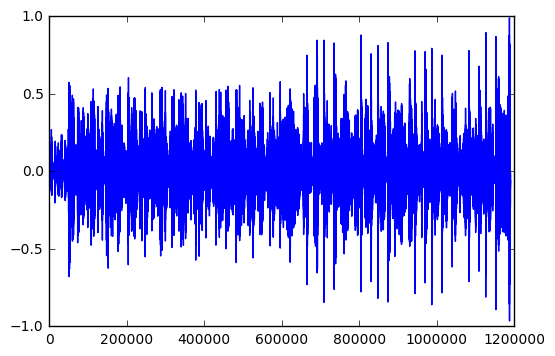

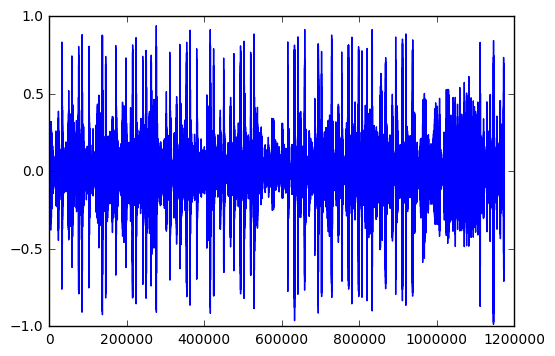

In [8]:
segments = []

#grab music chunks corresponding to beat segments
for j in xrange(len(boundaries_frames)-1):
    segment = get_music_samples(D_percussive_audio, boundaries_frames[j], boundaries_frames[j+1], hop_length)
    segments.append(segment)

segments = np.array(segments)
tune = np.array([])

#testing --> tune should be entire percussive component of song
print len(segments)
for segment in segments:
    plt.figure()
    plt.plot(segment)
    tune = np.concatenate((tune,segment))
Audio(tune, rate=sr)

In [9]:
indian_segments = []
counter = 0
#if indian segments exist, load, else populate the variable locally
try:
    indian_segments = pickle.load(open("indianSegments.pickle", "rb"))
except (OSError, IOError) as e:
    hop_length = 512
    for f in listdir('BeatsDatabase'):
        print counter
        path = 'BeatsDatabase/' + f
    
        indian_song, sr = librosa.load(path, sr=44100) 
        #gets indian audio beats
        tempo, beats = librosa.beat.beat_track(indian_song, sr=sr, hop_length=hop_length)
        #get segment boundaries 
        boundaries, labels = msaf.process(path, boundaries_id="foote")

        boundaries_final = [boundaries[0]]
        #check to see if any samples are too close together, delete if so
        for i in xrange(1,len(boundaries)-1):
            if boundaries[i] - boundaries[i-1] < 1.75:
                pass
            else:
                boundaries_final.append(boundaries[i])
        #converts to frames
        boundaries_frames = librosa.core.time_to_frames(boundaries_final, sr=sr)

        #grab music chunks corresponding to beat segments
        for j in xrange(len(boundaries_frames)-1):
            segment = get_music_samples(indian_song, boundaries_frames[j], boundaries_frames[j+1], hop_length)
            indian_segments.append(segment)
        print len(indian_segments)
        counter += 1
    #convert to np array
    indian_segments = np.array(indian_segments)
    pickle.dump( indian_segments, open( "indianSegments.pickle", "wb" ) )



In [10]:
#testing to ensure beats segmented appropriately
tune3 = np.array([])
for i in xrange(0, 100, 10):
    tune3 = np.concatenate((tune3, indian_segments[i]))
Audio(tune3, rate=sr)

In [11]:
#make spectrogram of inputted music segment
def makeSpectrogram(music):
    hop_length = 1024
    n_fft = 2048
    stft = librosa.stft(music, hop_length = hop_length, n_fft = n_fft)
    log_spectrogram = librosa.logamplitude(np.abs(stft**2), ref_power=np.max)
    return log_spectrogram


In [24]:
indian_spectrograms = []
counter = 0

#check if pickled indian spectrograms exist, if not populate with spectrograms of indian_segments
try:
    indian_spectrograms = pickle.load(open("indianSpectrograms.pickle", "rb"))
except (OSError, IOError) as e:
    for song in indian_segments:
        print counter
        print np.shape(song)
        spect = makeSpectrogram(song)
        indian_spectrograms.append(spect)
        counter += 1
    pickle.dump( indian_spectrograms, open( "indianSpectrograms.pickle", "wb" ) )


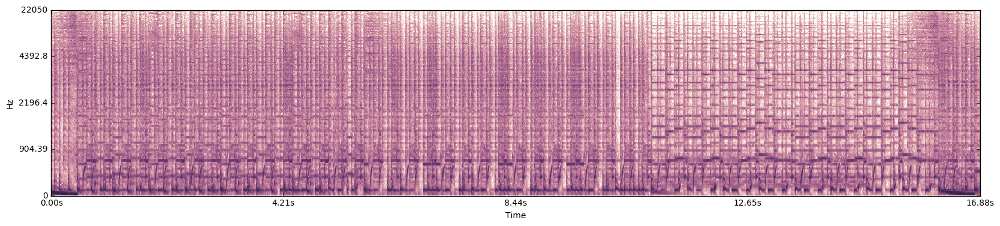

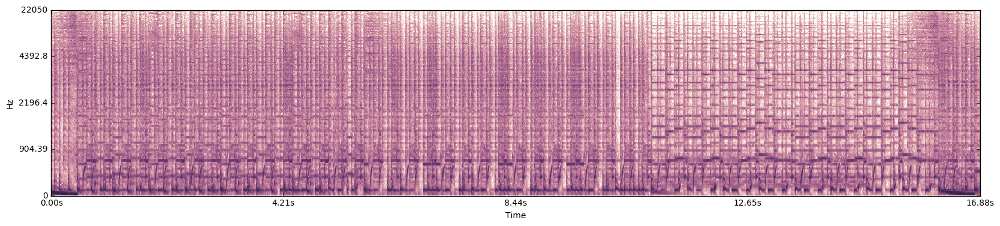

In [37]:
####TESTING TO MAKE SURE ORDER IS MAINTAINED IN PICKLING

plt.figure(figsize=(20, 4))
librosa.display.specshow(np.array(indian_spectrograms[100]), sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()
plt.figure()
plt.figure(figsize=(20, 4))

test = makeSpectrogram(indian_segments[100])
librosa.display.specshow(test, sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()


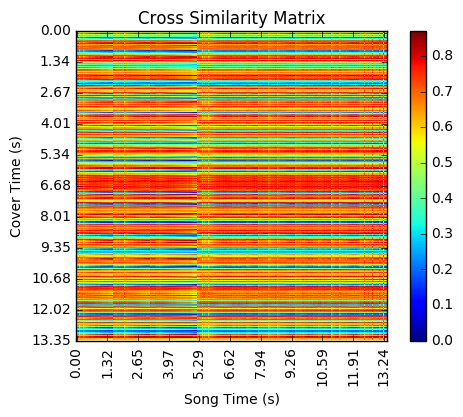

In [46]:
## YOUR ANSWER GOES HERE

def cross_sim_matrix(segment1, segment2, sample_rate, hop_length, display = True):
    """
        Input:
            feature_vectors - a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence.
            sample_rate - sample rate of the original audio
            hop_length - the length of the hop used in the representation
            distance_metric - which distance metric to use to compute similarity. Defaults to cosine.
            display - whether or not to display the similarity matrix after computing it. Defaults to True.
        Output:
            if display is True, plot the similarity matrix. Along the x and y axis of the similarity matrix, 
            the ticks should be in seconds not in samples. 
            returns sim_matrix - an NxN matrix with the pairwise distance between every feature vector.
    """
        
    D = sp.spatial.distance.cdist(segment1.T, segment2.T, metric='euclidean')

    #square up flattened array
    #D = sp.spatial.distance.squareform(D)
    #divide each element by max and then subtract from 1
    D_max = np.amax(D)  + .00000000001
    D = D / D_max
    S = 1 - D
    
    #plot figure
    if display == True:
        fig = plt.figure()
        plt.imshow(S, interpolation='nearest')
        skip_a = segment1.shape[-1] / 10
        skip_b = segment2.shape[-1] / 10
        plt.xticks(np.arange(0, segment1.shape[-1], skip_a), ['%.2f' % (i * hop_length / float(sample_rate)) for i in range(segment1.shape[-1])][::skip_a],rotation='vertical')
        plt.yticks(np .arange(0, segment2.shape[-1], skip_b), ['%.2f' % (i * hop_length / float(sample_rate)) for i in range(segment2.shape[-1])][::skip_b])
        plt.xlabel('Song Time (s)')
        plt.ylabel('Cover Time (s)')
        plt.title('Cross Similarity Matrix')
        plt.colorbar()
        plt.show()

# segment1 =  makeSpectrogram(segments[1])
# segment2 = makeSpectrogram(indian_segments[1])
# S = cross_sim_matrix(segment1, segment2, sr, hop_length, display = True)


In [ ]:
compatible_indian_beats = []
for hiphop_beat in segments:
    similarity_measure = float("-inf")
    for 